# Import packages

In [1]:
import pandas as pd
import numpy as np
from sklearn.svm import SVC
import matplotlib.pyplot as plt
from sklearn import datasets
import seaborn as sns

# Import data

In [2]:
# import some data to play with
iris = datasets.load_iris()
iris_df = pd.DataFrame(iris.data)
iris_df.columns = iris.feature_names

### Initial Exploration

In [3]:
iris_df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


In [4]:
iris_featues = iris_df.iloc[:,:2] # we only take the first two features
iris_labels = pd.Series(iris.target)

In [5]:
iris_featues.head()

,sepal length (cm),sepal width (cm)
0,5.1,3.5
1,4.9,3.0
2,4.7,3.2
3,4.6,3.1
4,5.0,3.6


We check how the classes are distributed

/opt/homebrew/Caskroom/miniforge/base/envs/ml/lib/python3.9/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:>

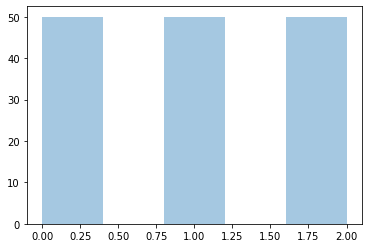

In [6]:
sns.distplot(iris_labels, bins=5, kde=False)

In [7]:
iris_labels.value_counts()

0    50
1    50
2    50
dtype: int64

### Plotting our classes

<AxesSubplot:xlabel='sepal length (cm)', ylabel='sepal width (cm)'>

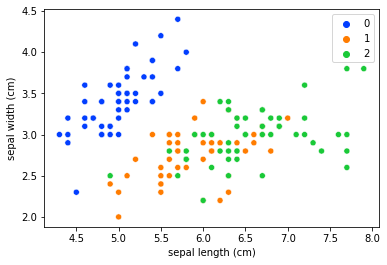

In [8]:
sns.scatterplot(
    x=iris_df['sepal length (cm)'], 
    y=iris_df['sepal width (cm)'], 
    hue=iris_labels, 
    palette=sns.color_palette('bright',3)
)

## Training an SVM and predicting

In [9]:
clf = SVC(kernel = 'linear')
clf.fit(iris_featues, iris_labels)

predictions = clf.predict(iris_featues)

In [10]:
results = pd.DataFrame({'Labels':iris_labels, 'Predictions':predictions})

In [11]:
pd.concat([iris_featues, results], axis=1, sort=False).tail(15)

,sepal length (cm),sepal width (cm),Labels,Predictions
135,7.7,3.0,2,2
136,6.3,3.4,2,2
137,6.4,3.1,2,2
138,6.0,3.0,2,1
139,6.9,3.1,2,2
140,6.7,3.1,2,2
141,6.9,3.1,2,2
142,5.8,2.7,2,1
143,6.8,3.2,2,2
144,6.7,3.3,2,2


## Visualizing the hyperparameters

### Plotting function

In [30]:
def plotSVC(svc, param, X, y):
    clf = svc
    clf.fit(X, y)

    plt.clf()
    plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=y, zorder=10, cmap=plt.cm.Paired,
                edgecolor='k', s=20)

    # Circle out the test data
    plt.scatter(clf.support_vectors_[:, 0], clf.support_vectors_[:, 1], s=80, facecolors='none',
                zorder=10, edgecolor='k')

    plt.axis('tight')
    x_min = X.iloc[:, 0].min()
    x_max = X.iloc[:, 0].max()
    y_min = X.iloc[:, 1].min()
    y_max = X.iloc[:, 1].max()

    XX, YY = np.mgrid[x_min:x_max:200j, y_min:y_max:200j]
    pre_z = svc.predict(np.c_[XX.ravel(), YY.ravel()])

    Z = pre_z.reshape(XX.shape)
    plt.contour(XX, YY, Z, 
                colors=['k', 'k', 'k'],
                linestyles=['--', '-', '--'])
    
    plt.pcolormesh(XX, YY, Z , cmap=plt.cm.cividis, shading='auto')
    plt.title(param)
    plt.show()

### Different behavior per Kernel

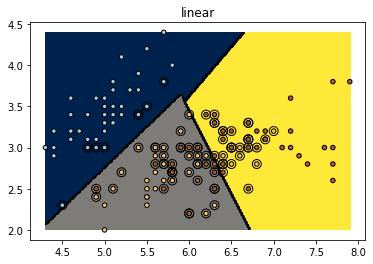

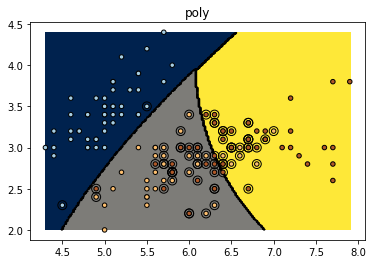

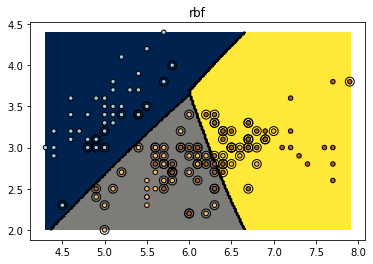

In [31]:
kernels = ['linear', 'poly', 'rbf']
for kernel in kernels:
    svc = SVC(kernel=kernel).fit(iris_featues, iris_labels)
    plotSVC(svc, kernel, iris_featues, iris_labels)

### Gamma

In [ ]:
gammas = [0.1, 1, 10, 100]
for gamma in gammas:
    svc = SVC(kernel='rbf', gamma=gamma).fit(iris_featues, iris_labels)
    plotSVC(svc ,gamma, iris_featues, iris_labels)

### C

In [ ]:
cs = [0.1, 1, 10, 100, 1000]
for c in cs:
    svc = SVC(kernel= 'rbf' , C=c).fit(iris_featues, iris_labels)
    plotSVC(svc, c, iris_featues, iris_labels)

### Polynomial Degree

Degree only applies to poly kernel

In [ ]:
degrees = [0, 1, 2, 3, 4, 5, 6]

for degree in degrees:
    svc = SVC(kernel='poly', degree=degree).fit(iris_featues, iris_labels)
    plotSVC(svc, degree, iris_featues, iris_labels)

## Create your own

In [ ]:
svc = SVC(kernel='linear', degree=1, gamma=1, C=10).fit(iris_featues, iris_labels)
plotSVC(svc, 'Your own', iris_featues, iris_labels)